<a href="https://colab.research.google.com/github/yashvichauhan/google_colab/blob/master/Neural_style_transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications.vgg19 import preprocess_input
from tensorflow.keras.models import Model
from matplotlib import pyplot as plt
import numpy as np
%matplotlib inline
print(tf.__version__)

2.2.0


In [ ]:
import time 
import IPython.display as display
import PIL.Image
import functools

In [ ]:
plt.rcParams['figure.figsize'] = (20,30)
plt.rcParams['figure.facecolor'] = 'w'

In [ ]:
content_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
style_path= tf.keras.utils.get_file('Art-style-graffiti-painting-1-1024x720.jpg','http://lava360.com/wp-content/uploads/2016/07/Art-style-graffiti-painting-1-1024x720.jpg')

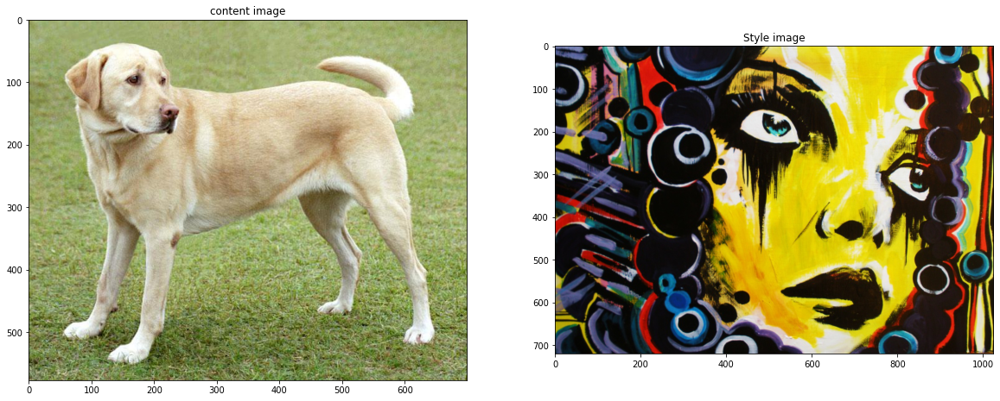

In [ ]:
content = plt.imread(content_path)
style= plt.imread(style_path)
fig,axs = plt.subplots(1,2)
axs[0].imshow(content)
axs[0].set_title('content image')
axs[1].imshow(style)
axs[1].set_title('Style image')
plt.show()

In [ ]:
def load_image(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

In [ ]:
content_t = load_image(content_path)
style_t = load_image(style_path)
print(content_t.shape)
print(style_t.shape)

(1, 422, 512, 3)
(1, 360, 512, 3)


In [ ]:
#our code

In [ ]:
vgg= tf.keras.applications.VGG19(include_top= False, weights='imagenet')
vgg.trainable = False

In [ ]:
for layer in vgg.layers:
  print(layer.name)

input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [ ]:
content_layers = ['block5_conv2']
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1',
                'block4_conv1',
                'block5_conv1']
num_c_layer = len(content_layers)
num_s_layer = len(style_layers)

In [ ]:
def vgg_layers(layer_name,model):
  output = [model.get_layer(name).output for name in layer_name]
  model = Model([vgg.input],output) 

  return model

In [ ]:
def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

In [ ]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self,style_layers,content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg = vgg_layers(style_layers + content_layers,vgg)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_s_layer = len(style_layers)
    self.vgg.trainable = False

  def call(self,inputs):
    inputs=inputs * 255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[: self.num_s_layer],outputs[self.num_s_layer:])

    style_outputs = [gram_matrix(style_output)
                      for style_output in style_outputs]

    content_dict = {content_name : value 
                    for content_name,value
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name : value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)} 
    
    return {'content': content_dict , 'style' : style_dict}


In [ ]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_t))

print('Styles:')
for name, output in sorted(results['style'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())
  print()

print("Contents:")
for name, output in sorted(results['content'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())


Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.0055228444
    max:  28014.557
    mean:  263.79025

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  61479.473
    mean:  9100.949

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.0
    max:  545623.3
    mean:  7660.9766

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  4320504.0
    mean:  134288.84

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  110005.38
    mean:  1487.0378

Contents:
   block5_conv2
    shape:  (1, 26, 32, 512)
    min:  0.0
    max:  2410.8796
    mean:  13.764149


In [ ]:
style_targets = extractor(style_t)['style']
content_targets = extractor(content_t)['content']

In [ ]:
image = tf.Variable(content_t)

In [ ]:
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)


In [ ]:
opt = tf.optimizers.Adam(learning_rate=0.2,beta_1=0.99, epsilon=1e-1)

In [ ]:
style_weight = 1e-2
content_weight = 1e4

In [ ]:
#loss function
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_s_layer

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_c_layer
    loss = style_loss + content_loss
    return loss


In [ ]:
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))
  

In [ ]:
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)


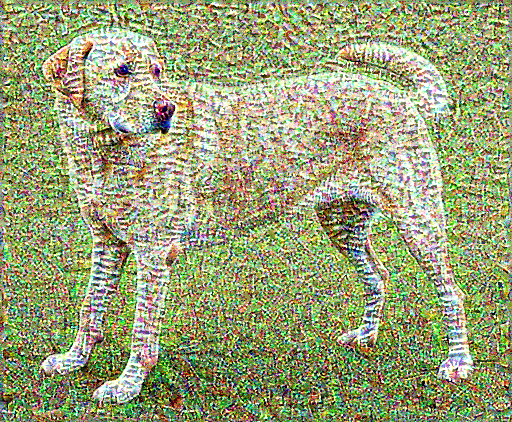

In [ ]:
train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

epoch : 0
....................................................................................................

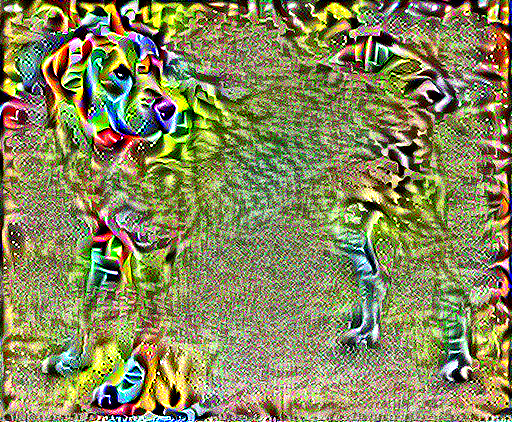

epoch : 1
....................................................................................................

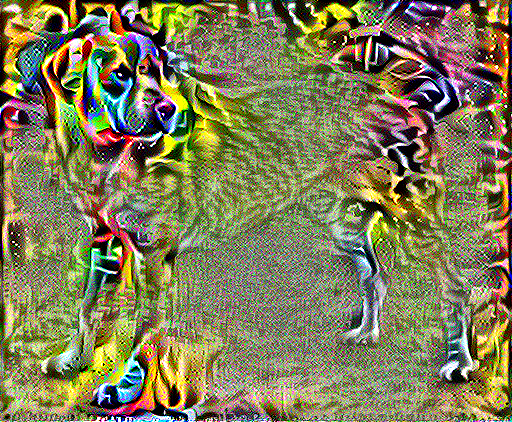

epoch : 2
....................................................................................................

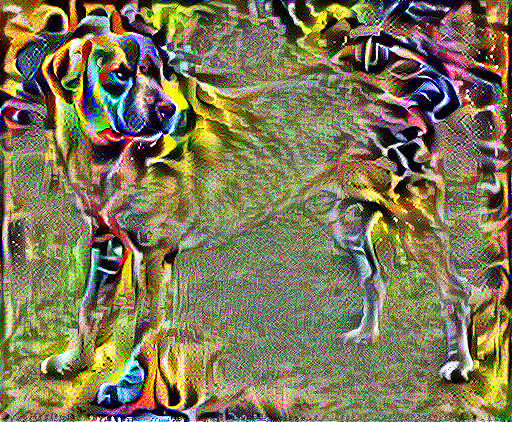

epoch : 3
....................................................................................................

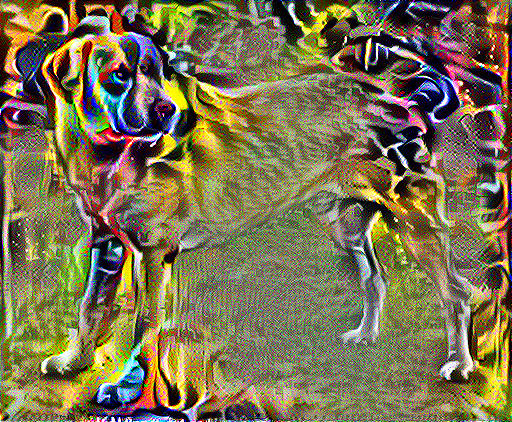

epoch : 4
....................................................................................................

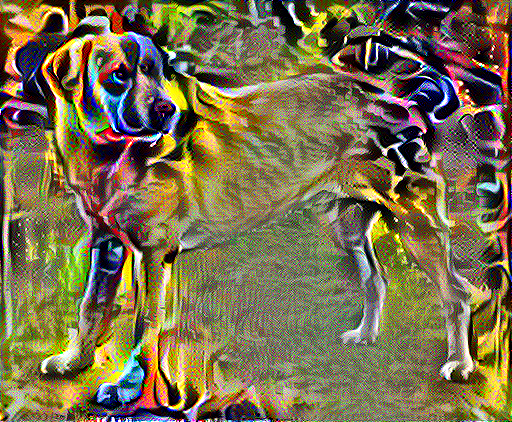

epoch : 5
....................................................................................................

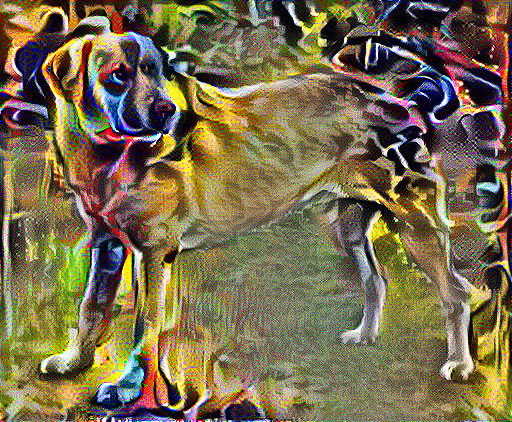

epoch : 6
....................................................................................................

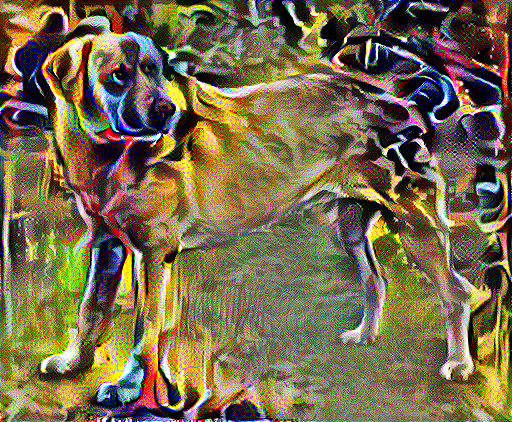

epoch : 7
....................................................................................................

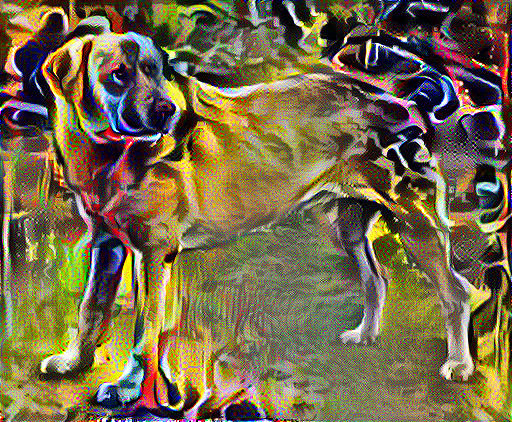

epoch : 8
....................................................................................................

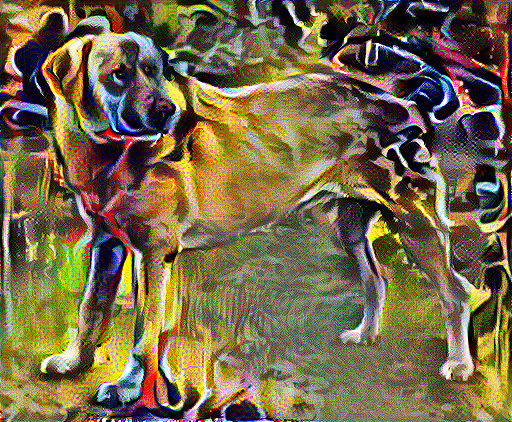

epoch : 9
....................................................................................................

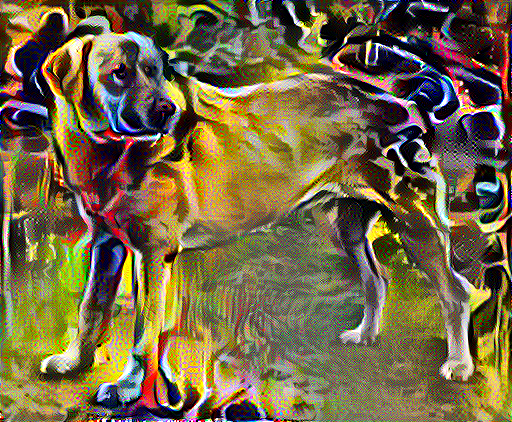

epoch : 10
....................................................................................................

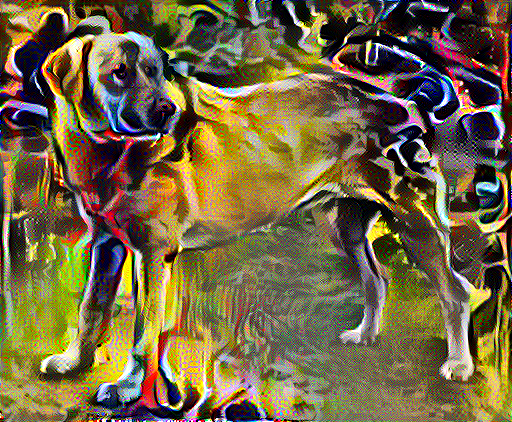

epoch : 11
....................................................................................................

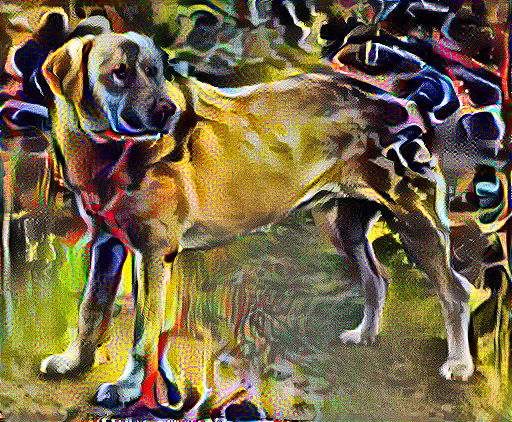

epoch : 12
....................................................................................................

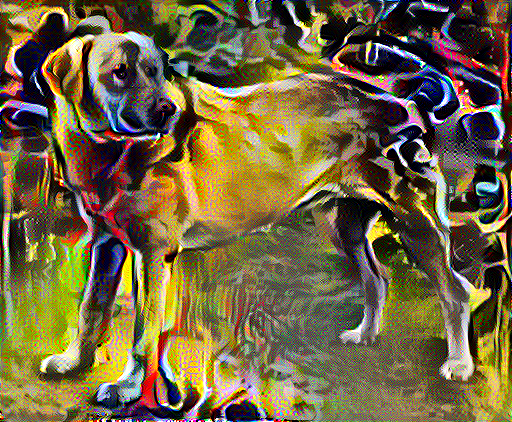

epoch : 13
....................................................................................................

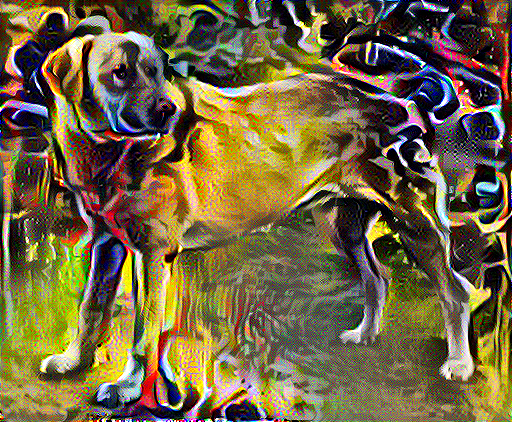

epoch : 14
....................................................................................................

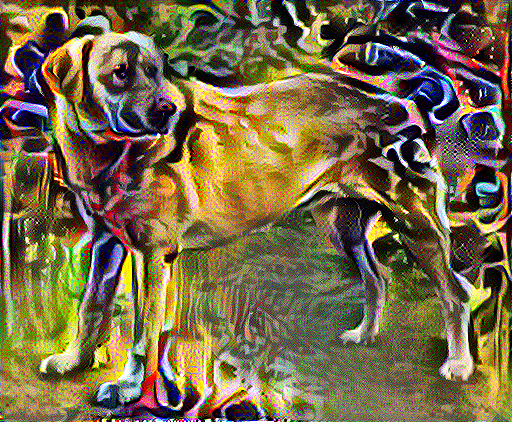

epoch : 15
....................................................................................................

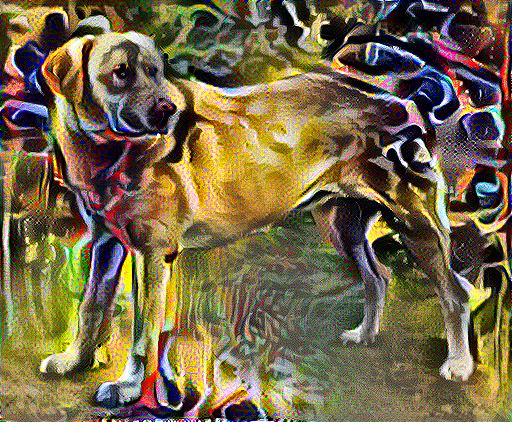

epoch : 16
....................................................................................................

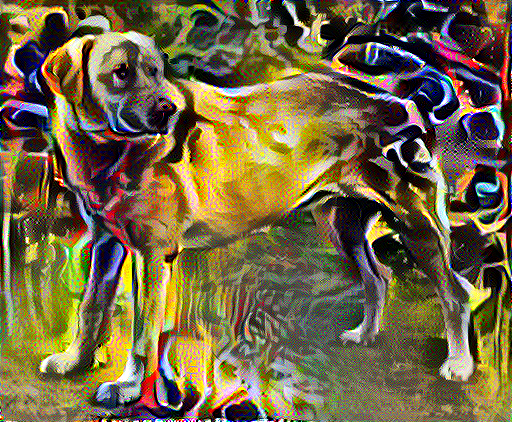

epoch : 17
....................................................................................................

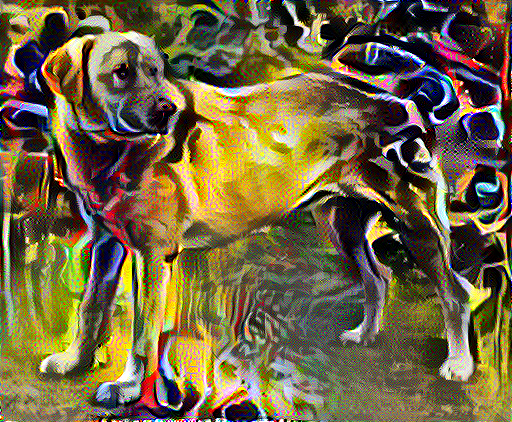

epoch : 18
....................................................................................................

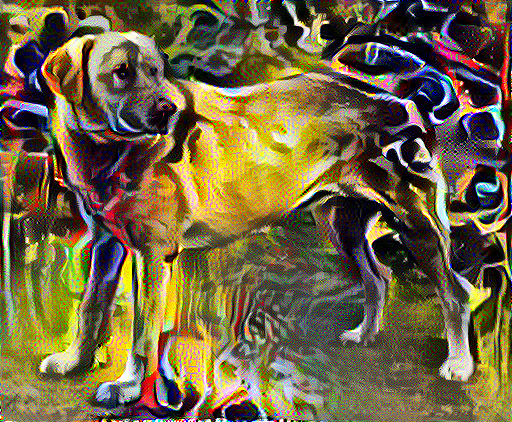

epoch : 19
....................................................................................................

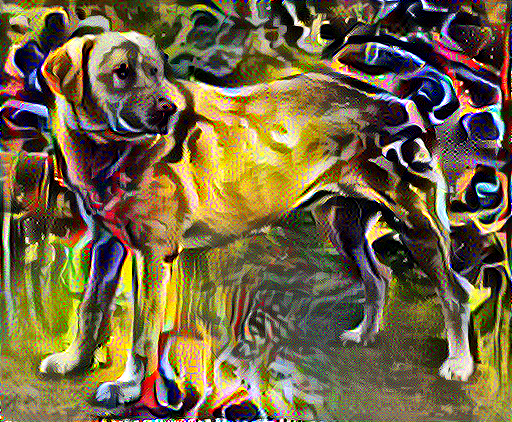

epoch : 20
....................................................................................................

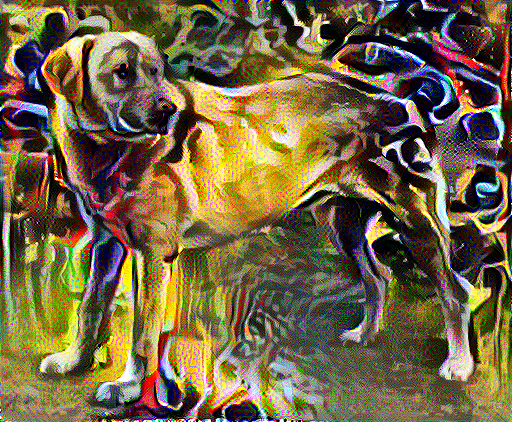

epoch : 21
....................................................................................................

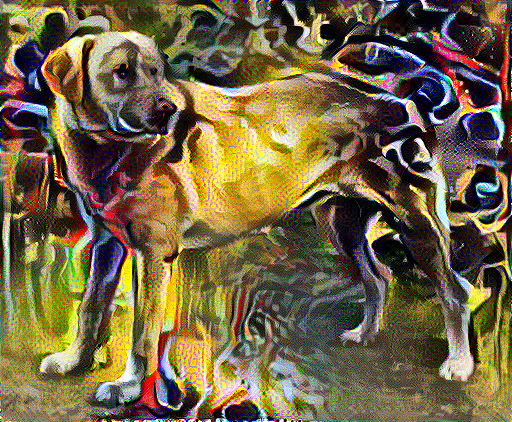

epoch : 22
....................................................................................................

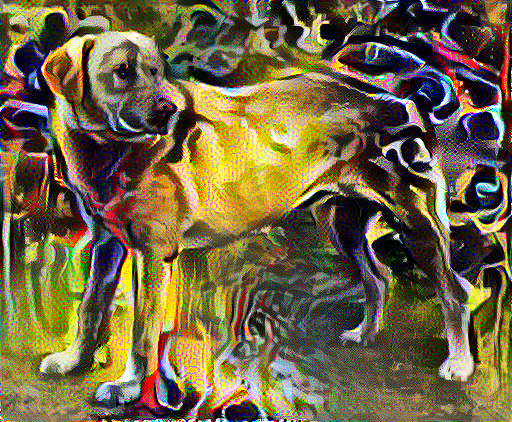

epoch : 23
....................................................................................................

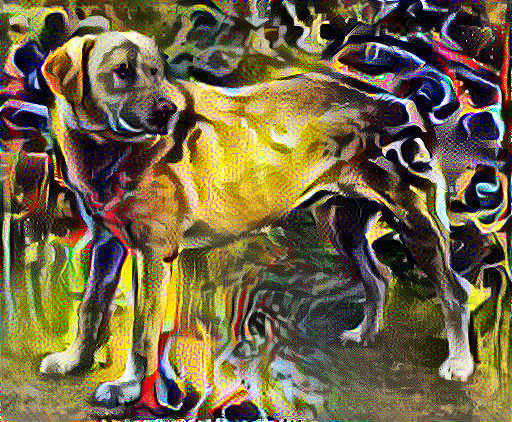

epoch : 24
....................................................................................................

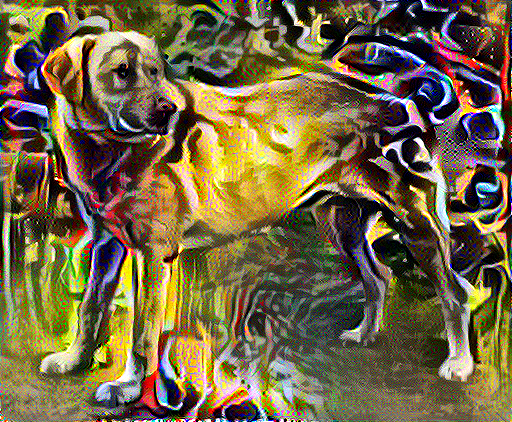

epoch : 25
....................................................................................................

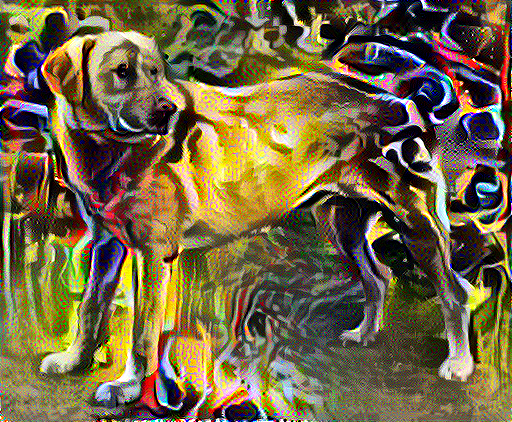

epoch : 26
....................................................................................................

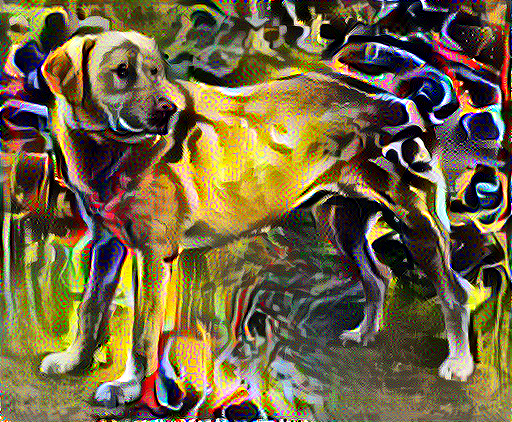

epoch : 27
....................................................................................................

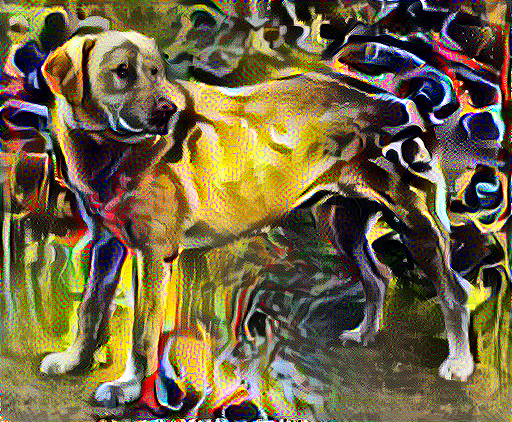

epoch : 28
....................................................................................................

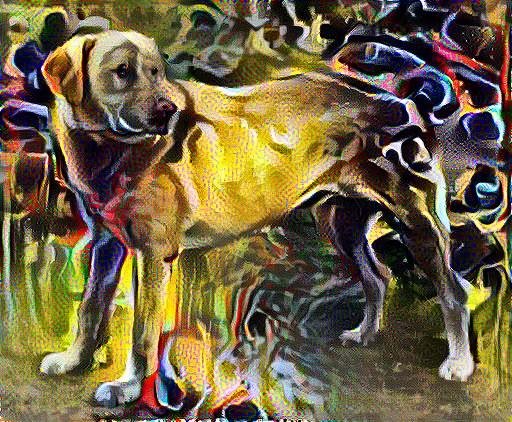

epoch : 29
....................................................................................................

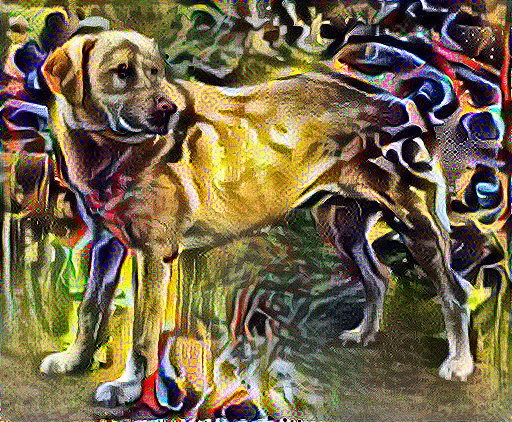

epoch : 30
....................................................................................................

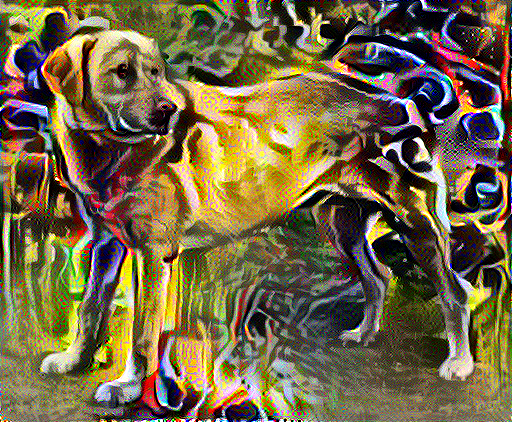

epoch : 31
....................................................................................................

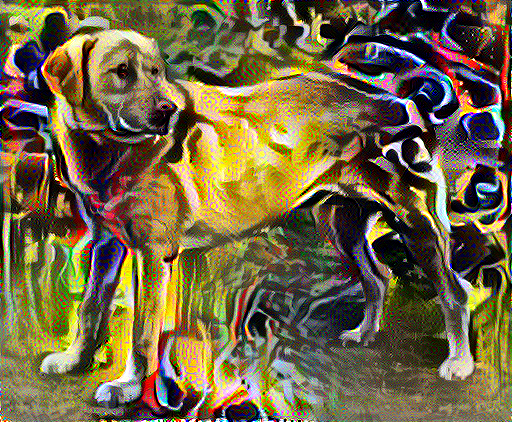

epoch : 32
....................................................................................................

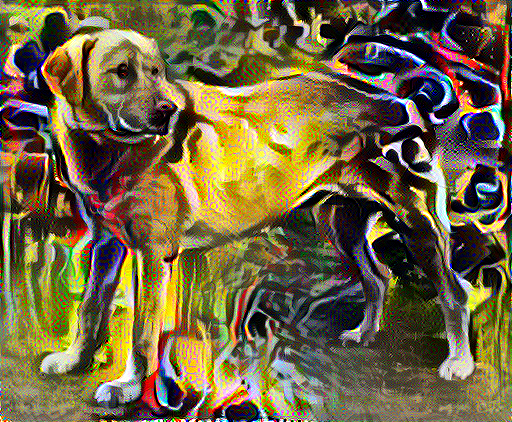

epoch : 33
....................................................................................................

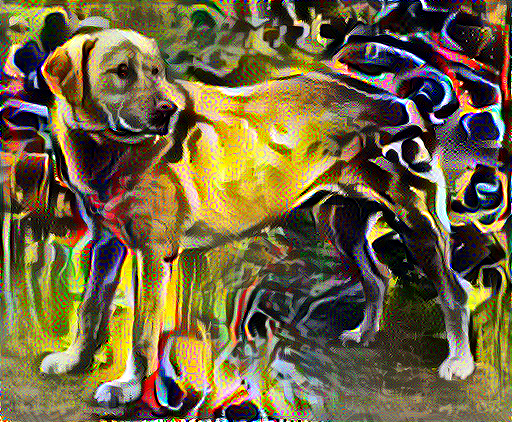

epoch : 34
....................................................................................................

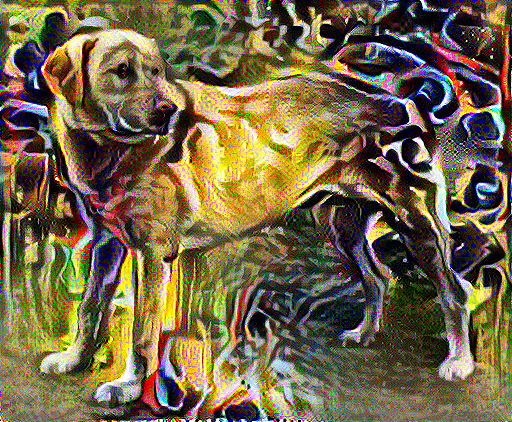

epoch : 35
....................................................................................................

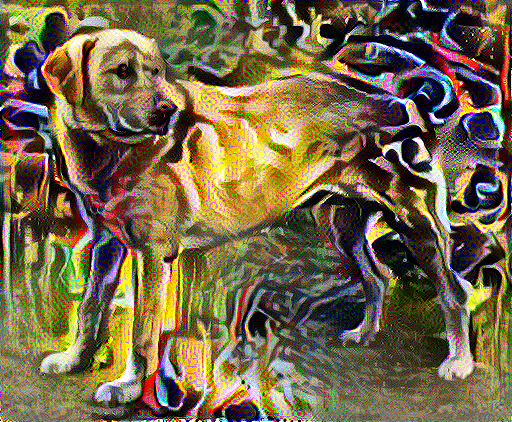

epoch : 36
....................................................................................................

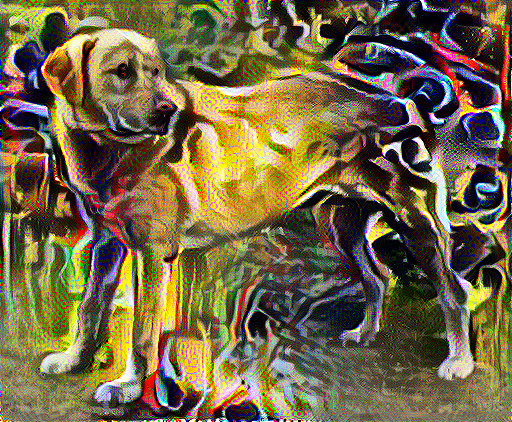

epoch : 37
....................................................................................................

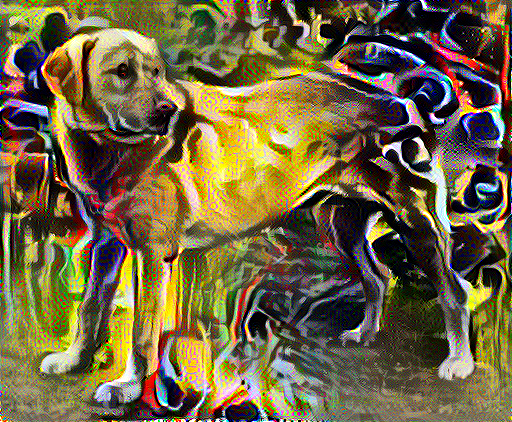

epoch : 38
....................................................................................................

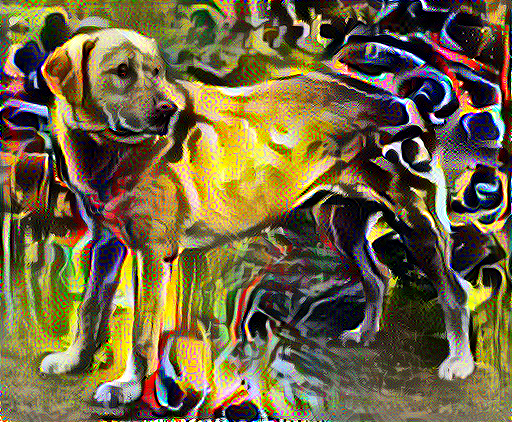

epoch : 39
....................................................................................................

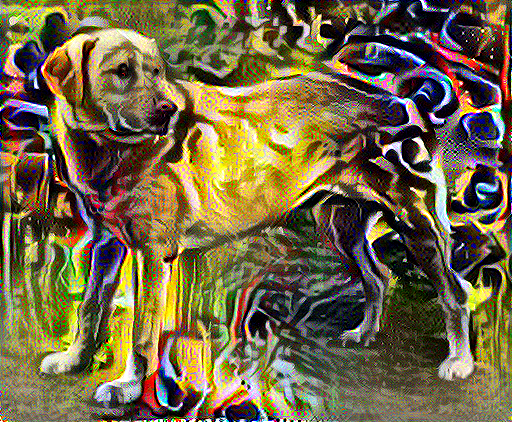

epoch : 40
....................................................................................................

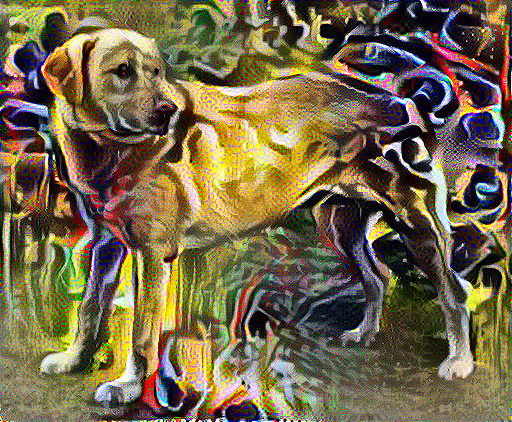

epoch : 41
....................................................................................................

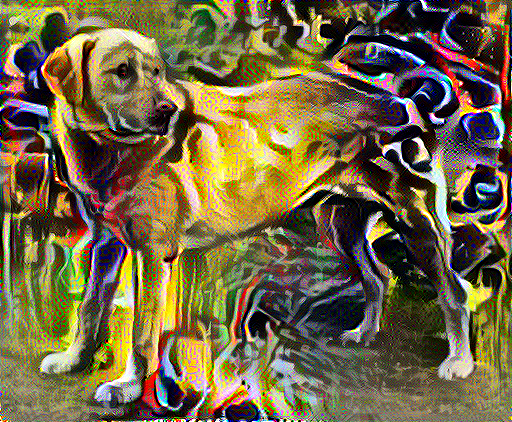

epoch : 42
....................................................................................................

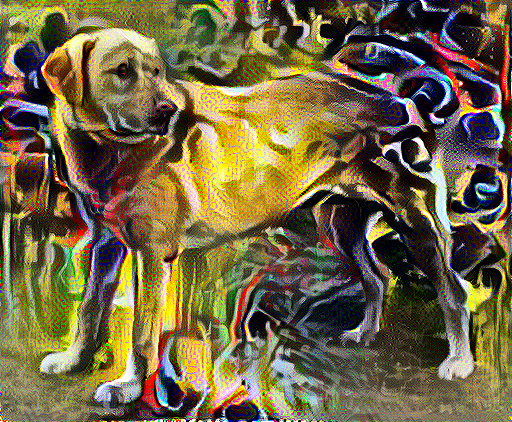

epoch : 43
....................................................................................................

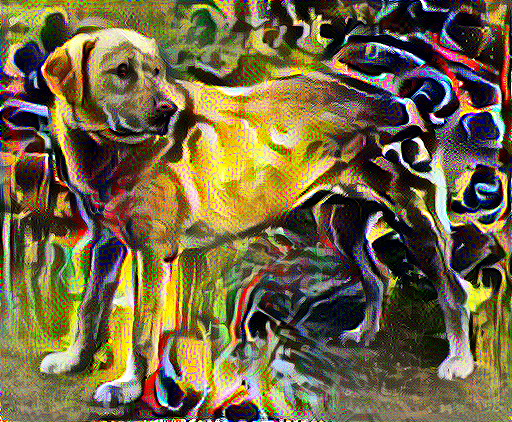

epoch : 44
....................................................................................................

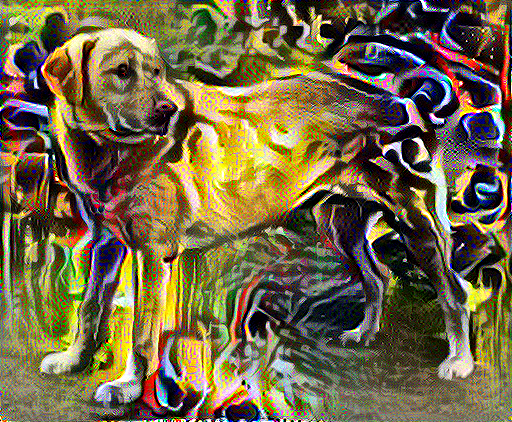

epoch : 45
....................................................................................................

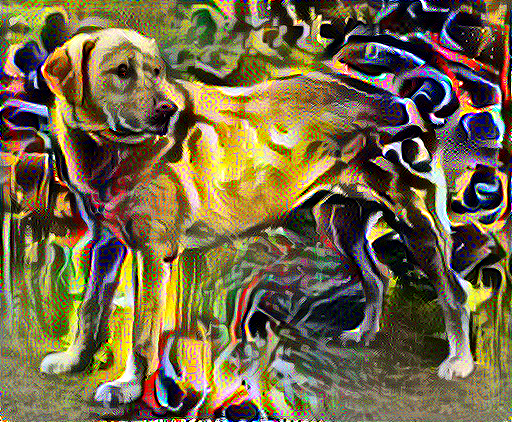

epoch : 46
....................................................................................................

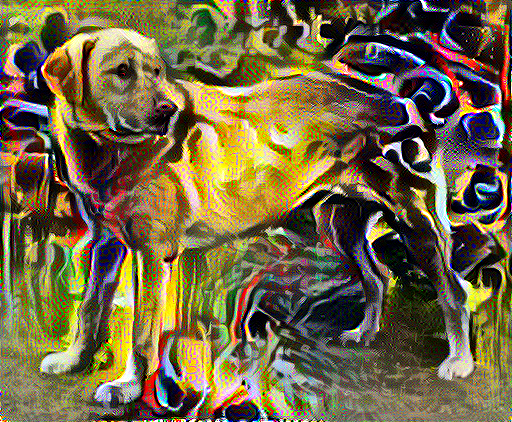

epoch : 47
....................................................................................................

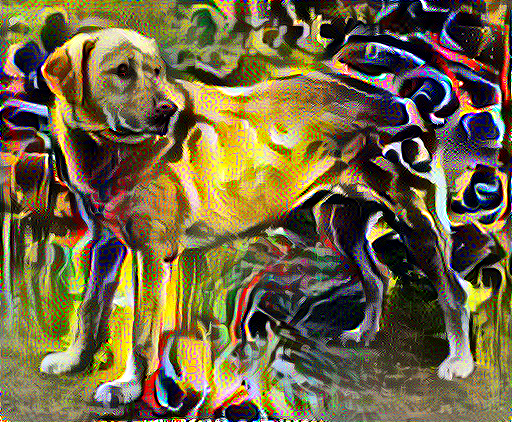

epoch : 48
....................................................................................................

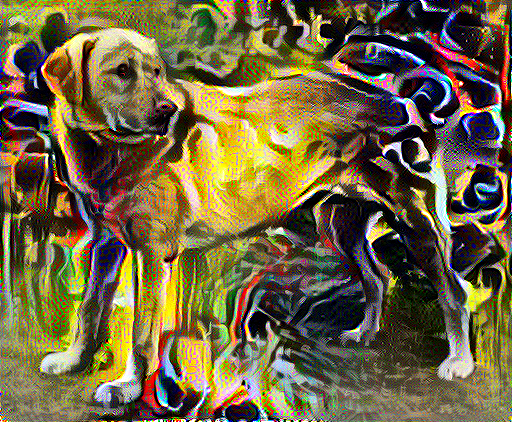

epoch : 49
....................................................................................................

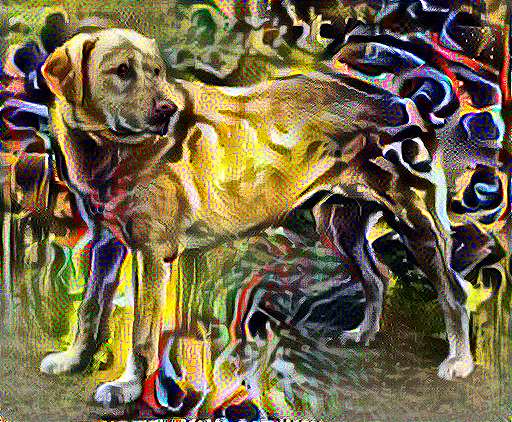

Total time: 1005.4


In [ ]:
import time
start = time.time()

epochs = 50
steps_per_epoch = 100

step = 0
for n in range(epochs):
  print("epoch : "+str(n))
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='')
  #display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  
end = time.time()
print("Total time: {:.1f}".format(end-start))
